# Ex 16 흐린사진을 선명하게

## 프로젝트 1-1

* 직접 고른 이미지로 SRGAN 실험하기
1. (적당히) 높은 해상도를 가진 이미지를 검색해서 한 장 고른 후 저장하고 불러옵니다.
2. 불러온 이미지에 bicubic interpolation을 적용해 가로 및 세로 픽셀 수를 1/4로 줄입니다. cv2.resize()를 사용해 봅시다.
3. 줄인 저해상도 이미지를 입력으로 SRGAN을 이용해 고해상도 이미지를 생성합니다. 이전에 사용한 apply_srgan 함수를 사용하면 쉽습니다.
4. 2.의 이미지에 bicubic interpolation을 적용해 가로 및 세로 픽셀 수를 다시 4배로 늘립니다. 마찬가지로 cv2.resize()를 사용해 봅시다.
5. 3개 이미지(4.의 Bicubic의 결과, 3.의 SRGAN의 결과, 1.의 원래 고해상도 이미지)를 나란히 시각화합니다. 각 이미지의 제목에 어떤 방법에 대한 결과인지 표시해 주세요. 이전 시각화에 사용했던 코드를 참고하면 어렵지 않습니다.
6. 선택한 이미지를 DIV2K 데이터셋에서 학습된 모델로 Super Resolution했을 때 어떠한 결과가 나왔으며, 왜 이러한 결과가 출력되었는지 설명해 봅시다. (정답은 없습니다)

In [1]:
import tensorflow as tf
import os
import cv2
from matplotlib import pyplot as plt
model_file = os.getenv('HOME')+'/aiffel/super_resolution/srgan_G.h5'
srgan = tf.keras.models.load_model(model_file)
img_path = os.getenv('HOME')+'/aiffel/ykb/Ex16/high3.jpg'
high=cv2.imread(img_path)

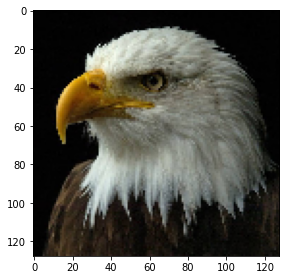

In [2]:
import numpy as np

def apply_srgan(image):
    image = tf.cast(image[np.newaxis, ...], tf.float32)
    sr = srgan.predict(image)
    sr = tf.clip_by_value(sr, 0, 255)
    sr = tf.round(sr)
    sr = tf.cast(sr, tf.uint8)
    return np.array(sr)[0]

high2=cv2.resize(high,dsize=(0,0),fx=0.25,fy=0.25, interpolation=cv2.INTER_CUBIC)
plt.figure(figsize=(15,6))
plt.subplot(1,3,1)
plt.imshow(cv2.cvtColor(high2, cv2.COLOR_BGR2RGB))
srgan_hr = apply_srgan(high2)


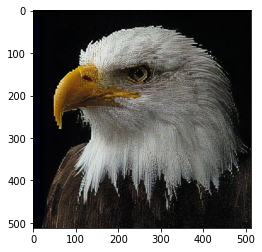

In [3]:
plt.imshow(cv2.cvtColor(srgan_hr, cv2.COLOR_BGR2RGB))

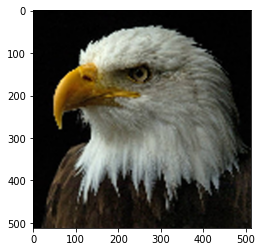

In [4]:
high3=cv2.resize(high2,dsize=(0,0),fx=4,fy=4, interpolation=cv2.INTER_CUBIC)
plt.imshow(cv2.cvtColor(high3, cv2.COLOR_BGR2RGB))

Text(0.5, 1.0, 'Bicubic Image')

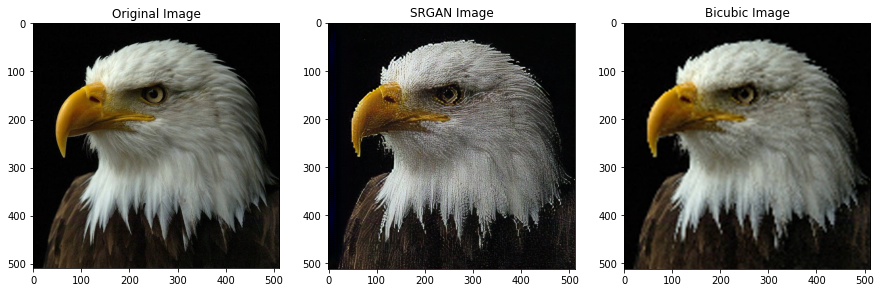

In [5]:
plt.figure(figsize=(15,6))
ax=plt.subplot(1,3,1)
plt.imshow(cv2.cvtColor(high, cv2.COLOR_BGR2RGB))
ax.set_title('Original Image')
ax=plt.subplot(1,3,2)
plt.imshow(cv2.cvtColor(srgan_hr, cv2.COLOR_BGR2RGB))
ax.set_title('SRGAN Image')
ax=plt.subplot(1,3,3)
plt.imshow(cv2.cvtColor(high3, cv2.COLOR_BGR2RGB))
ax.set_title('Bicubic Image')

### 결과 확인하기

* 원본 이미지에 비해 SRGAN이미지는 부드럽진 않지만 좀더 과도하게 선명해진 느낌이 있었습니다.
* SRGAN은 원데이터의 확률 분포에 해당하는 이미지를 만듭니다.말그대로 확률 분포이기 때문에 원본과 완전히 똑같은 이미지로는 할 수 없으며 확률분포 안의 데이터로 복원하기 때문에 원본과 이미지 차이가 납니다.

## 프로젝트 1-2

1. (적당히) 낮은 해상도를 가진 이미지를 검색해서 한 장 고른 후 저장하고 불러옵니다.
2. 불러온 이미지를 입력으로 SRGAN을 이용해 고해상도 이미지를 생성합니다. 이전에 사용한 apply_srgan 함수를 사용하면 쉽습니다.
3. 1.에서 불러온 이미지에 bicubic interpolation을 적용해 가로 및 세로 픽셀 수를 다시 4배로 늘립니다. cv2.resize()를 사용해 봅시다.
4. 2개 이미지(3.의 Bicubic의 결과, 2.의 SRGAN의 결과)를 나란히 시각화합니다. 각 이미지의 제목에 어떤 방법에 대한 결과인지 표시해 주세요. 이전 시각화에 사용했던 코드를 참고하면 어렵지 않습니다.
5. 선택한 이미지를 DIV2K 데이터셋에서 학습된 모델로 Super Resolution했을 때 어떠한 결과가 나왔으며, 왜 이러한 결과가 출력되었는지 설명해 봅시다. (정답은 없습니다)

In [6]:
img_path = os.getenv('HOME')+'/aiffel/ykb/Ex16/low7.jpg'
low=cv2.imread(img_path)

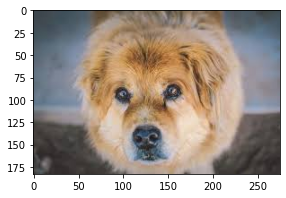

In [7]:
plt.figure(figsize=(15,6))
plt.subplot(1,3,1)
plt.imshow(cv2.cvtColor(low, cv2.COLOR_BGR2RGB))
srgan_hr = apply_srgan(low)

In [8]:
low2=cv2.resize(low,dsize=(0,0),fx=4,fy=4, interpolation=cv2.INTER_CUBIC)

Text(0.5, 1.0, 'Bicubic Image')

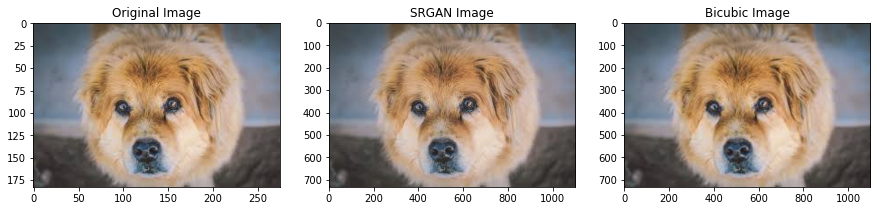

In [9]:
plt.figure(figsize=(15,6))
ax=plt.subplot(1,3,1)
plt.imshow(cv2.cvtColor(low, cv2.COLOR_BGR2RGB))
ax.set_title('Original Image')
ax=plt.subplot(1,3,2)
plt.imshow(cv2.cvtColor(srgan_hr, cv2.COLOR_BGR2RGB))
ax.set_title('SRGAN Image')
ax=plt.subplot(1,3,3)
plt.imshow(cv2.cvtColor(low2, cv2.COLOR_BGR2RGB))
ax.set_title('Bicubic Image') 

Text(0.5, 1.0, 'Bicubic Image')

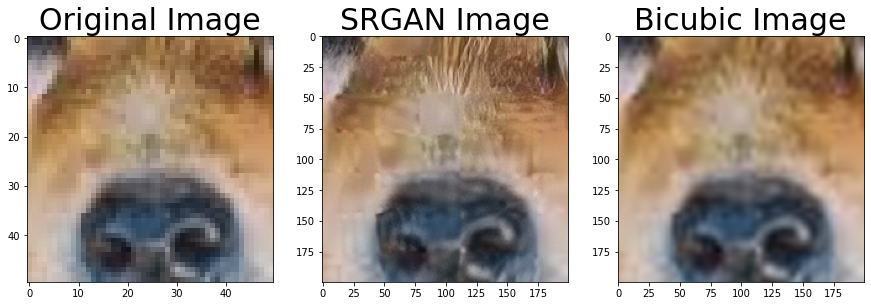

In [10]:
def crop(image, left_top, x=50, y=50):
    
    return image[left_top[0]:(left_top[0]+x), left_top[1]:(left_top[1]+y), :]

# interpolation된 이미지와 고해상도 이미지의 동일한 부분을 각각 잘라냅니다.
left_top = (100,100)
crop_low = crop(low, left_top)


plt.figure(figsize=(15,25))
plt.subplot(1,3,1); plt.imshow(cv2.cvtColor(crop_low, cv2.COLOR_BGR2RGB)); plt.title("Original Image", fontsize=30)

left_top = (400,400)
crop_srgan_hr = crop(srgan_hr, left_top,x=200,y=200)
plt.subplot(1,3,2); plt.imshow(cv2.cvtColor(crop_srgan_hr, cv2.COLOR_BGR2RGB)); plt.title("SRGAN Image", fontsize=30)

left_top = (400,400)
crop_low2 = crop(low2, left_top,x=200,y=200)
plt.subplot(1,3,3); plt.imshow(cv2.cvtColor(crop_low2, cv2.COLOR_BGR2RGB)); plt.title("Bicubic Image", fontsize=30)

### 결과 확인하기

* 원본 이미지에 비해 SRGAN 이미지는 좀더 선명해졌습니다. 낮은 해상도의 이미지를 SRGAN을 통해 고해상도로 올리면서 선명해진 결과입니다.

## 프로젝트 2: SRGAN을 이용해 고해상도 gif생성하기

In [11]:
import cv2

# 다운받은 파일의 경로를 설정해 주세요.
gif_path = os.getenv('HOME')+'/aiffel/ykb/Ex16/fire_lr.gif'
gif = cv2.VideoCapture(gif_path)

isTrue = True
frames = []
while isTrue:
    isTrue, frame = gif.read()
    if isTrue:
        frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
        frames.append(frame)
print("frame 수 :", len(frames))
print("frame 크기 :", (frames[0].shape))

frame 수 : 14
frame 크기 : (282, 300, 3)


In [12]:
new_frame_CB,new_frame_GAN=[],[]

for frame in frames:
    temp1=cv2.resize(frame,dsize=(0,0),fx=4,fy=4, interpolation=cv2.INTER_CUBIC)
    temp2= apply_srgan(frame)
    new_frame_CB.append(temp1)
    new_frame_GAN.append(temp2)


Text(0.5, 1.0, 'Bicubic Image')

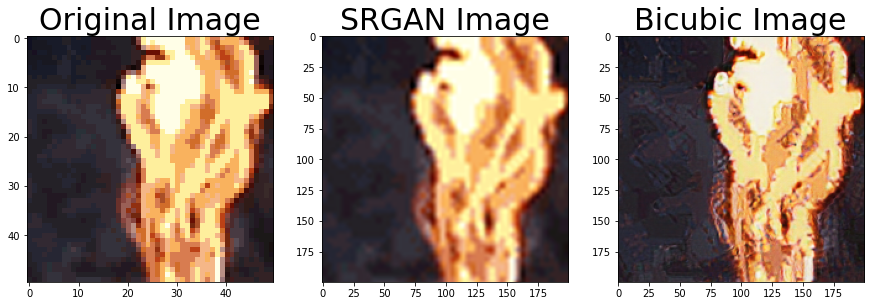

In [13]:
left_top = (130,130)
crop_ori = crop(frames[1], left_top,x=50,y=50)
plt.figure(figsize=(15,25))
plt.subplot(1,3,1); plt.imshow(crop_ori); plt.title("Original Image", fontsize=30)


left_top = (520,520)
crop_CB = crop(new_frame_CB[1], left_top,x=200,y=200)
plt.subplot(1,3,2); plt.imshow(crop_CB); plt.title("SRGAN Image", fontsize=30)

left_top = (520,520)
crop_GAN = crop(new_frame_GAN[1], left_top,x=200,y=200)
plt.subplot(1,3,3); plt.imshow(crop_GAN); plt.title("Bicubic Image", fontsize=30)

In [14]:
import imageio

imageio.mimsave("Bicubic.gif", new_frame_CB)
imageio.mimsave("SRGAN.gif", new_frame_GAN)

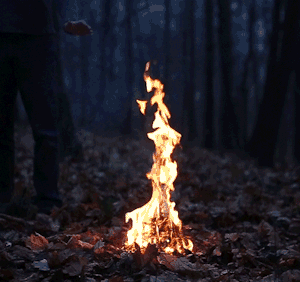

In [15]:
from IPython.display import Image as show_gif

show_gif("fire_lr.gif", width=400) # width 는 적당히 큰 값으로 설정해주세요

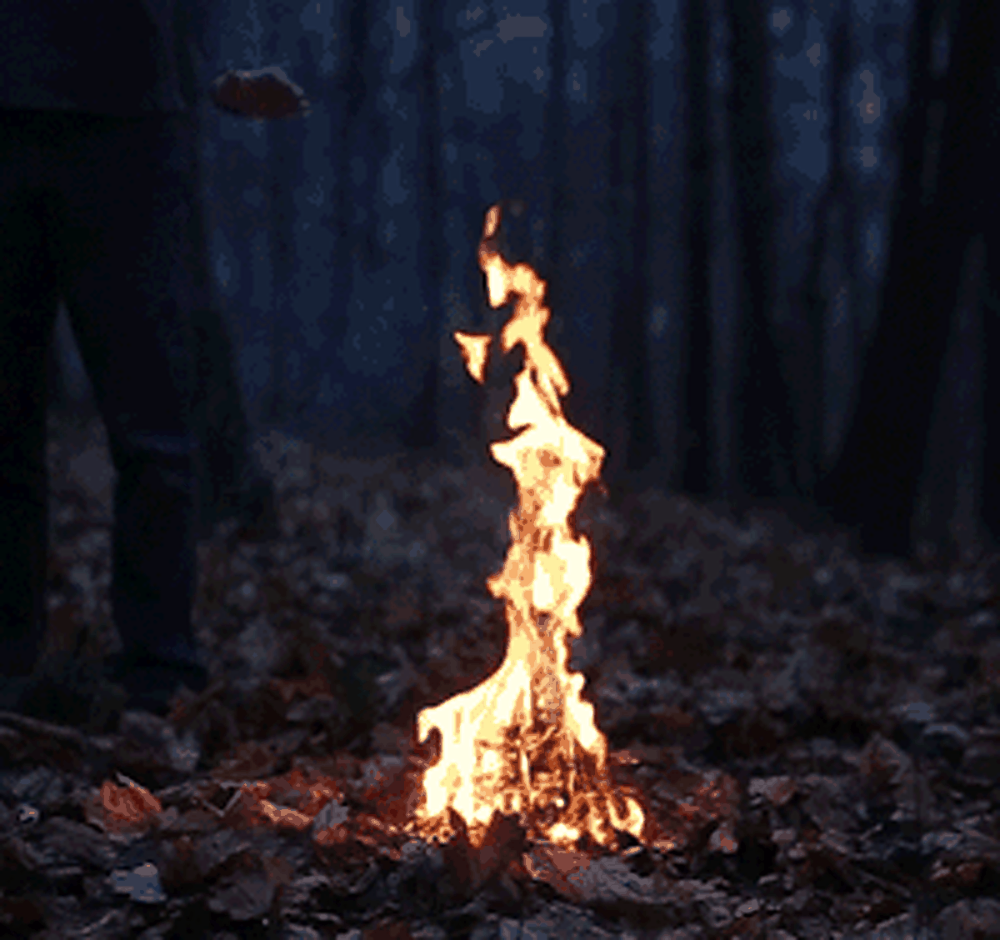

In [16]:
show_gif("Bicubic.gif", width=400) # width 는 적당히 큰 값으로 설정해주세요

## 회고

* pre train된 모델로 하니 시간을 단축할 수 있었습니다. 많은 pre-trained 모델이 있는 걸로 알고있습니다. 다른 프로젝트를 할 때도 pre-trained 모델이 있나 잘 살펴봐야할 것 같습니다.
* 예전에 티비에서 봤던 ai를 통한 화질 개선이 이렇게 간단하게 할수있다는 것이 신기했고 재미있었습니다. 